# BreastDCEDL
## BreastDCEDL Data Explore and Visualize
## Use this demo after downloading data !

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/naomifridman/BreastDCEDL/blob/main/BrestDCEDL_demo_on_local_data_min_crop.ipynb)


#### Author: Bubby Solway
#### Date: 2025-09-22
> BreastDCEDL/BrestDCEDL_demo_on_local_data_min_crop.ipynb


In [30]:
from sklearn.metrics import classification_report,auc,roc_auc_score
from PIL import Image
import time
from pathlib import Path


import os
import numpy as np
import pandas as pd
from PIL import Image


import warnings
warnings.filterwarnings('ignore', '.*do not.*', )
warnings.warn('Do not show this message')

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from glob import glob
#from skimage import io
from sklearn.utils import shuffle

#from nipype.interfaces.ants import N4BiasFieldCorrection
import sys
import os
import ast
import re
import nibabel as nib
import warnings
warnings.filterwarnings('ignore')

In [31]:
def show_n_images(
    imgs,
    cmap="gray",
    titles=None,
    enlarge=4,
    mtitle=None,
    cut=False,
    axis_off=True,
    fontsize=15,
    cb=False,
):
    """Visualise *n* images side-by-side."""
    _ = plt.figure(figsize=(enlarge * len(imgs), enlarge * 2))
    for i, im in enumerate(imgs, 1):
        ax = plt.subplot(1, len(imgs), i)
        if cb and len(np.unique(im)) > 5:
            im = cont_br(im)
        ax.imshow(im[50:290, 75:450] if cut else im, cmap=cmap, origin="lower")
        if titles is not None:
            ax.set_title(titles[i - 1], fontsize=fontsize)
        if axis_off:
            ax.axis("off")
    if mtitle:
        plt.suptitle(mtitle, fontsize=fontsize + 2)
    plt.tight_layout(); plt.show()


In [32]:
# --------------------------------------------------------------------- #
#                       NIfTI I/O utilities                             #
# --------------------------------------------------------------------- #

def _ds_from_pid(pid: str) -> str:
    if "ISPY1" in pid:
        return "spy1"
    if ("ISPY2" in pid) or ("ACRIN-6698" in pid):
        return "spy2"
    if "Breast_MRI" in pid:
        return "duke"
    raise ValueError(f"Cannot infer dataset for pid={pid!r}")




def read_nifti(path: str) -> np.ndarray:
    return nib.load(path).get_fdata()

def _last_int(path):
    m = re.search(r"(\d+)\.nii\.gz$", path)
    return int(m.group(1)) if m else -1


def get_all_nifti_acquisitions(pid):

    ds   = _ds_from_pid(pid)

    dpath = nifti_path[ds]
    if deb: print(ds, nifti_path[ds])

    ff = [x for x in os.listdir(dpath) if pid in x]
    if deb:print(os.listdir(dpath)[:7],pid)
    if deb:print(ff)


    img = []
    for f in ff:
        x = read_nifti(os.path.join(dpath, f))
        img.append(x)

    return img

def get_sorted_nifti_acquisitions(pid):

    ds   = _ds_from_pid(pid)

    data_path = nifti_path[ds]
    if deb: print(ds, nifti_path[ds])

    ff = [x for x in os.listdir(data_path) if pid in x]
    if deb:print(os.listdir(data_path)[:7],pid)
    if deb:print(ff)
    sorted_filenames = sorted(ff, key=_last_int)

    img = []
    for f in sorted_filenames:
        x = read_nifti(os.path.join(data_path, f))
        img.append(x)

    return img


def get_nifti_mask(pid: str):

    ds   = _ds_from_pid(pid)

    mpath = mask_path[ds]
    if deb: print(ds, mpath)

    ff = [x for x in os.listdir(mpath) if pid in x]

    if deb:print(ff)
    if len(ff)==0: return None

    f=ff[0]


    x = read_nifti(os.path.join(mpath, f))


    return x


In [33]:
def minmax(m):
    if m.max()==0:
        return m
    m = (m-m.min())/(m.max()-m.min())
    return m

def to_rgb(a,b,c):

    stack_axis = a.ndim

    # Stack along the next axis
    im = np.stack([minmax(a), minmax(b), minmax(c)], axis=stack_axis)

    return im

# Setup path's to downloaded data
## If data saved in Google Drive and you run from Colab, mount drive and set path

In [34]:
# set to base of your local nifti data
data_path="G:\\My Drive\\breast_mri\\BreastDCEDL_min_crop"

In [35]:
# Check if running in Google Colab

if 'google.colab' in str(get_ipython()):
    # Clone the repository
    !git clone https://github.com/naomifridman/BreastDCEDL.git

    # Change to the repository directory
    os.chdir('/content/BreastDCEDL')

    from google.colab import drive
    drive.mount('/content/drive')

    data_path='/content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/'

fatal: destination path 'BreastDCEDL' already exists and is not an empty directory.
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [36]:
# Set up your local nifti path's

nifti_path= {'spy2':os.path.join(data_path,"BreastDCEDL_ISPY2_min_crop","dce"),
                        'spy1':os.path.join(data_path,"BreastDCEDL_ISPY1_min_crop","dce"),
                        'duke':os.path.join(data_path,"BreastDCEDL_DUKE_min_crop","dce")}

mask_path={'spy2':os.path.join(data_path,"BreastDCEDL_ISPY2_min_crop","mask"),
                    'spy1':os.path.join(data_path,"BreastDCEDL_ISPY1_min_crop","mask")
                    }

In [37]:
!ls

BreastDCEDL				      images
BreastDCEDL_metadata.csv		      ISPY1
BreastDCEDL_metadata_min_crop.csv	      ISPY2
BreastDCEDL_min_crop.csv		      LICENSE
BrestDCEDL_demo.ipynb			      README.md
BrestDCEDL_demo_on_local_data_min_crop.ipynb  spy1_min_crop_samples
BrestDCEDL_vit_predict.ipynb		      transformer_models
DUKE					      utils


## Load and view metada

In [38]:
df=pd.read_csv('BreastDCEDL_metadata_min_crop.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2072 entries, 0 to 2071
Data columns (total 29 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   pid             2072 non-null   object 
 1   pCR             1432 non-null   float64
 2   n_xy            2072 non-null   float64
 3   n_z             2072 non-null   float64
 4   n_times         2072 non-null   float64
 5   pre             2072 non-null   float64
 6   post_early      2072 non-null   float64
 7   post_late       2072 non-null   float64
 8   slice_thick     2072 non-null   float64
 9   xy_spacing      2072 non-null   float64
 10  mask_start      2072 non-null   float64
 11  mask_end        2072 non-null   float64
 12  sraw            2072 non-null   float64
 13  eraw            2072 non-null   float64
 14  scol            2072 non-null   float64
 15  ecol            2072 non-null   float64
 16  tum_vol         2071 non-null   float64
 17  age             2072 non-null   f

In [39]:
df.test.value_counts(dropna=False)

,count
test,
0.0,1533
1.0,271
2.0,268


In [40]:
df.pCR.value_counts(dropna=False)

,count
pCR,
0.0,1005
NaN,640
1.0,427


In [41]:
pd.crosstab(df.test,df.pCR, dropna=False)

pCR,0.0,1.0,NaN
test,,,
0.0,762,321,450
1.0,122,53,96
2.0,121,53,94


In [42]:
pd.crosstab(df.test,df.HR, dropna=False)

HR,0.0,1.0,NaN
test,,,
0.0,542,989,2
1.0,98,173,0
2.0,100,168,0


In [43]:
pd.crosstab(df.test,df.HER2, dropna=False)

HER2,0.0,1.0,NaN
test,,,
0.0,1186,344,3
1.0,213,56,2
2.0,211,57,0


In [44]:
os.listdir(nifti_path['spy2'])[:8]

['ISPY1_1069_spy2_vis1_dce_aqc_2.nii.gz',
 'ISPY1_1001_spy2_vis1_dce_aqc_0.nii.gz',
 'ISPY1_1001_spy2_vis1_dce_aqc_1.nii.gz',
 'ISPY1_1001_spy2_vis1_dce_aqc_2.nii.gz',
 'ISPY2-105513_spy2_vis1_dce_aqc_2.nii.gz',
 'ISPY2-105513_spy2_vis1_dce_aqc_0.nii.gz',
 'ISPY2-105513_spy2_vis1_dce_aqc_5.nii.gz',
 'ISPY1_1215_spy2_vis1_dce_aqc_0.nii.gz']

In [45]:
os.listdir(mask_path['spy2'])[:8]

['ACRIN-6698-102212_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-103939_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-104268_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-107700_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-108969_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-115987_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-116603_spy2_vis1_mask.nii.gz',
 'ACRIN-6698-118307_spy2_vis1_mask.nii.gz']

## I-SPY-2 example

In [46]:
df[df.pid.isin(['ACRIN-6698-102212','ISPY2-550421'])]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
0,ACRIN-6698-102212,0.0,256.0,38.0,8.0,0.0,2.0,6.0,2.0,0.605500,...,1.0,0.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy2,1.0
642,ISPY2-550421,0.0,256.0,66.0,7.0,0.0,2.0,6.0,1.0,0.688073,...,0.0,1.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy2,0.0


In [47]:
deb=1

spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/dce
['ISPY1_1069_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_1.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_5.nii.gz'] ACRIN-6698-102212
['ACRIN-6698-102212_spy2_vis1_dce_aqc_6.nii.gz', 'ACRIN-6698-102212_spy2_vis1_dce_aqc_2.nii.gz', 'ACRIN-6698-102212_spy2_vis1_dce_aqc_0.nii.gz']
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/mask
['ACRIN-6698-102212_spy2_vis1_mask.nii.gz']
dce 38 256 (42, 256, 256) mask:  2 39 (42, 256, 256)


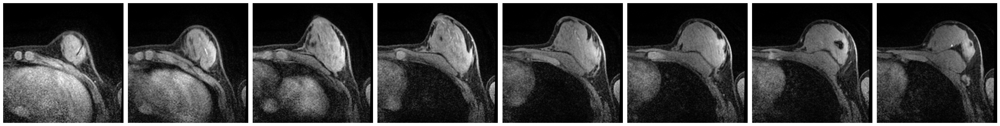

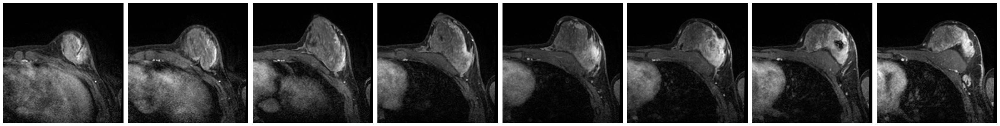

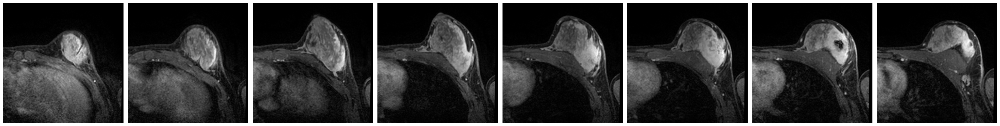

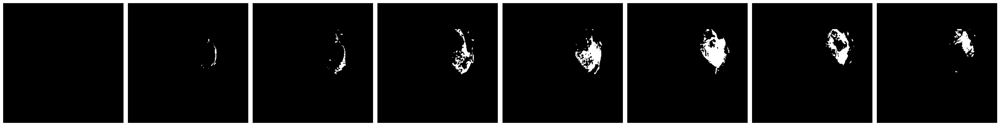

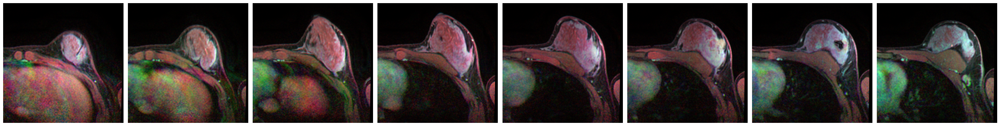

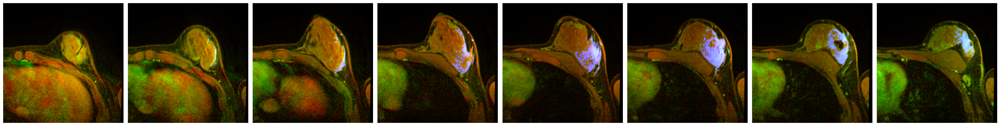

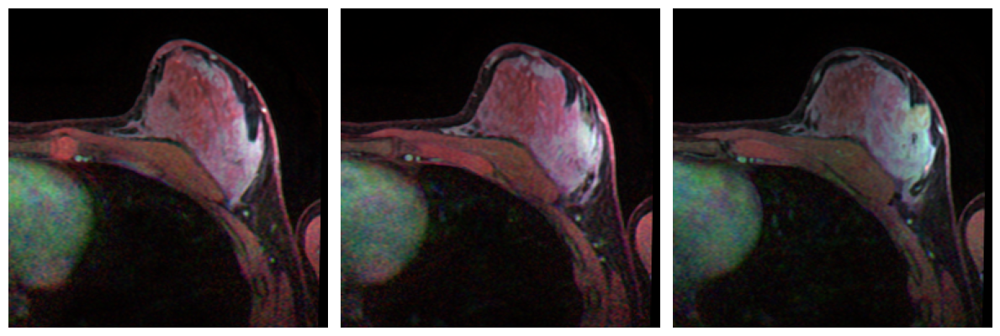

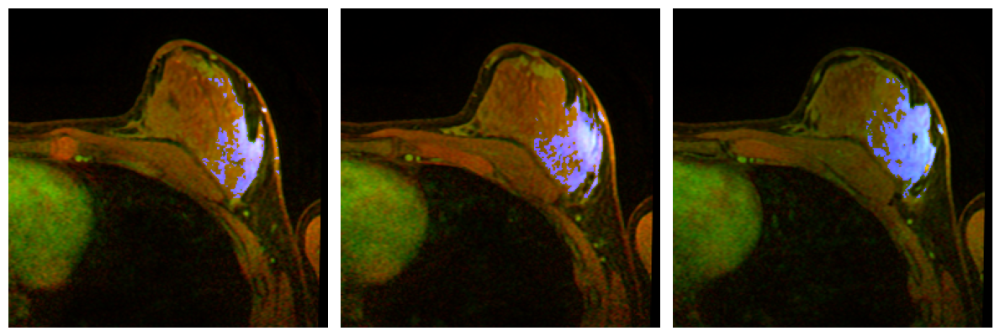

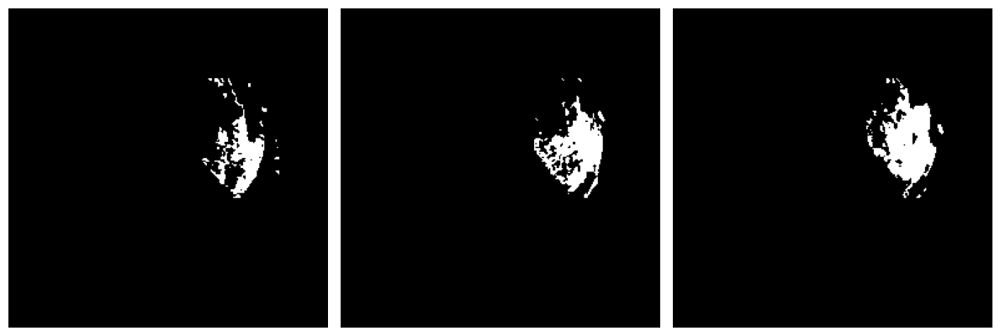

In [48]:

    pid='ACRIN-6698-102212'

    row = df[df.pid==pid].iloc[0]
    smask=int(row['mask_start'])
    emask = int(row['mask_end'])
    pmask = (smask+emask)//2
    nz=int(row['n_z'])
    nxy=int(row['n_xy'])


    d=get_sorted_nifti_acquisitions(pid)
    m = get_nifti_mask(pid)

    print('dce',nz,nxy,d[0].shape, 'mask: ', smask,emask,  m.shape)

    show_n_images([d[0][k] for k in range(0,nz,5)])
    show_n_images([d[1][k] for k in range(0,nz,5)])
    show_n_images([d[2][k] for k in range(0,nz,5)])
    show_n_images([m[k] for k in range(0,nz,5)])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in range(0,nz,5)])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in range(0,nz,5)])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in [pmask-3,pmask,pmask+3]])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in [pmask-3,pmask,pmask+3]])
    show_n_images([ m[k] for k in [pmask-3,pmask,pmask+3]])




In [49]:
!ls /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/mask/*ACRIN-6698-102212*

/content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/mask/ACRIN-6698-102212_spy2_vis1_mask.nii.gz


In [50]:
len(d),d[0].shape,m.shape

(3, (42, 256, 256), (42, 256, 256))

mask:  2 67
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/dce
['ISPY1_1069_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_1.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_5.nii.gz'] ISPY2-550421
['ISPY2-550421_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY2-550421_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-550421_spy2_vis1_dce_aqc_6.nii.gz']
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/mask
['ISPY2-550421_spy2_vis1_mask.nii.gz']


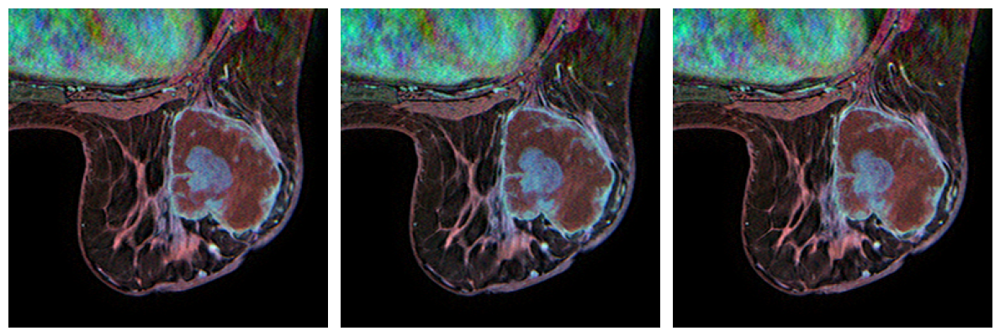

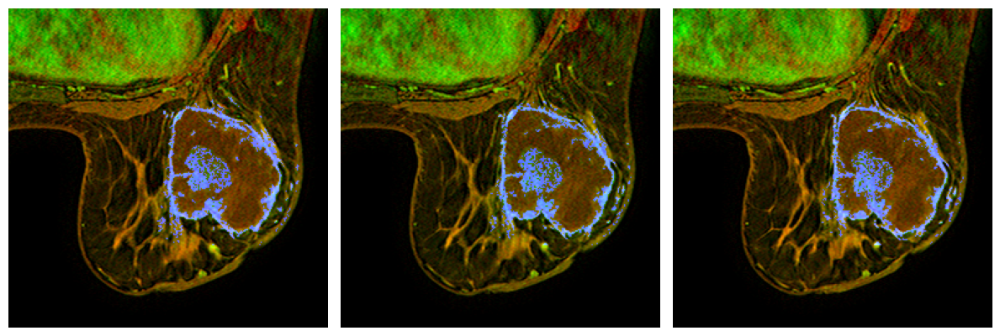

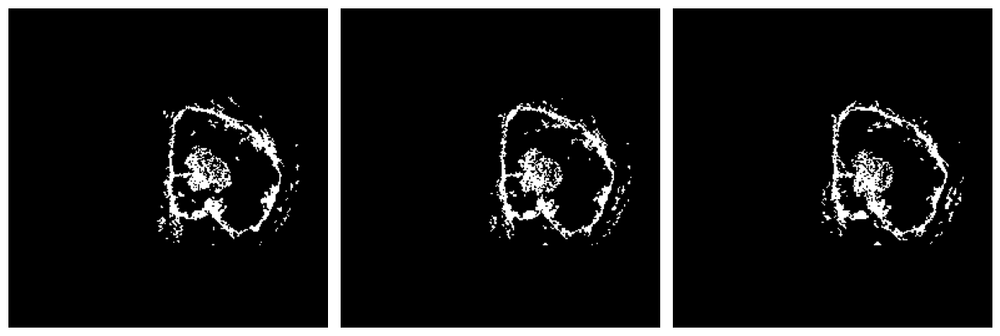

In [51]:
    pid='ISPY2-550421'

    row = df[df.pid==pid].iloc[0]
    smask=int(row['mask_start'])
    emask = int(row['mask_end'])
    pmask = (smask+emask)//2
    nz=int(row['n_z'])
    nxy=int(row['n_xy'])
    print('mask: ', smask,emask)

    d=get_sorted_nifti_acquisitions(pid)
    m = get_nifti_mask(pid)

    im=to_rgb(d[0],d[1], d[2])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([ m[k] for k in [pmask-1,pmask,pmask+1]])





mask:  2 59
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/dce
['ISPY1_1069_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_1.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_5.nii.gz'] ACRIN-6698-283070
['ACRIN-6698-283070_spy2_vis1_dce_aqc_2.nii.gz', 'ACRIN-6698-283070_spy2_vis1_dce_aqc_5.nii.gz', 'ACRIN-6698-283070_spy2_vis1_dce_aqc_0.nii.gz']
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/mask
['ACRIN-6698-283070_spy2_vis1_mask.nii.gz']


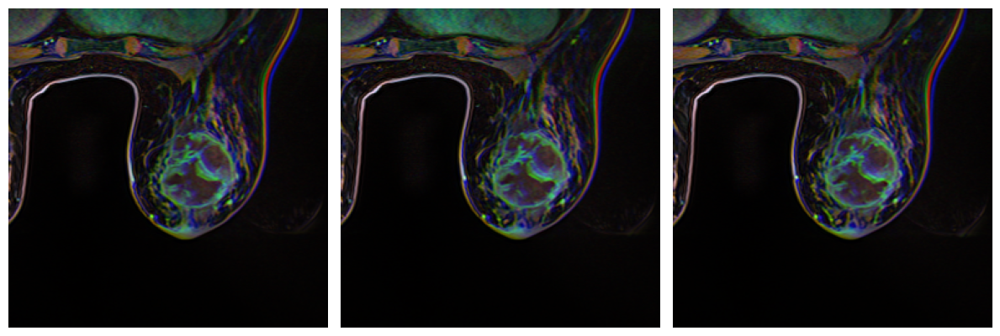

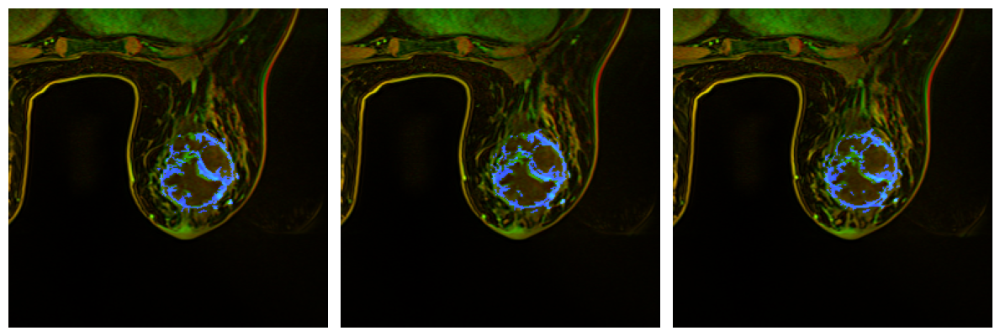

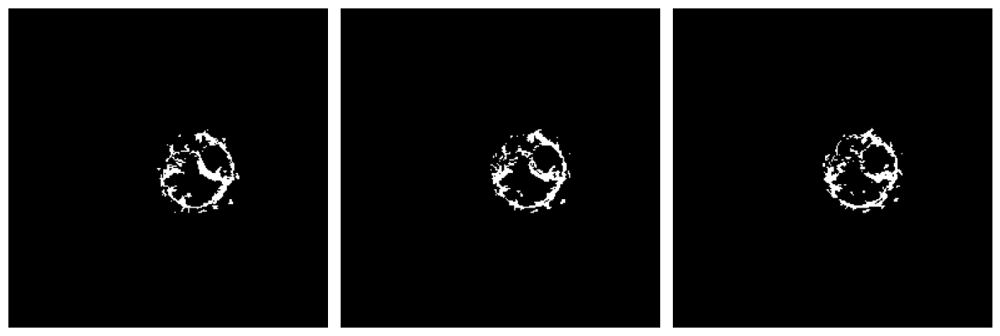

In [52]:
    pid='ACRIN-6698-283070'

    row = df[df.pid==pid].iloc[0]
    smask=int(row['mask_start'])
    emask = int(row['mask_end'])
    pmask = (smask+emask)//2
    nz=int(row['n_z'])
    nxy=int(row['n_xy'])
    print('mask: ', smask,emask)

    d=get_sorted_nifti_acquisitions(pid)
    m = get_nifti_mask(pid)

    im=to_rgb(d[0],d[1], d[2])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([ m[k] for k in [pmask-1,pmask,pmask+1]])





mask:  2 25
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/dce
['ISPY1_1069_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_1.nii.gz', 'ISPY1_1001_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_2.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_0.nii.gz', 'ISPY2-105513_spy2_vis1_dce_aqc_5.nii.gz'] ACRIN-6698-511851
['ACRIN-6698-511851_spy2_vis1_dce_aqc_0.nii.gz', 'ACRIN-6698-511851_spy2_vis1_dce_aqc_5.nii.gz', 'ACRIN-6698-511851_spy2_vis1_dce_aqc_2.nii.gz']
spy2 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY2_min_crop/mask
['ACRIN-6698-511851_spy2_vis1_mask.nii.gz']


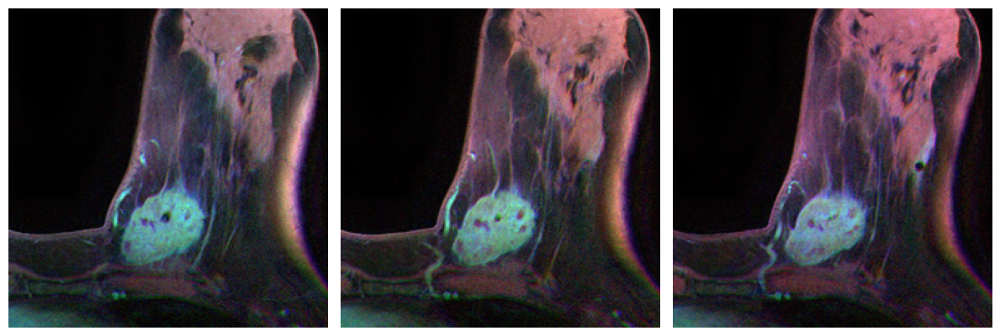

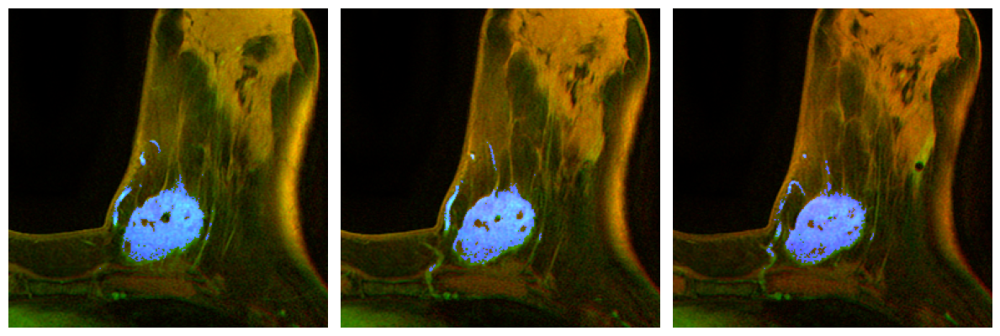

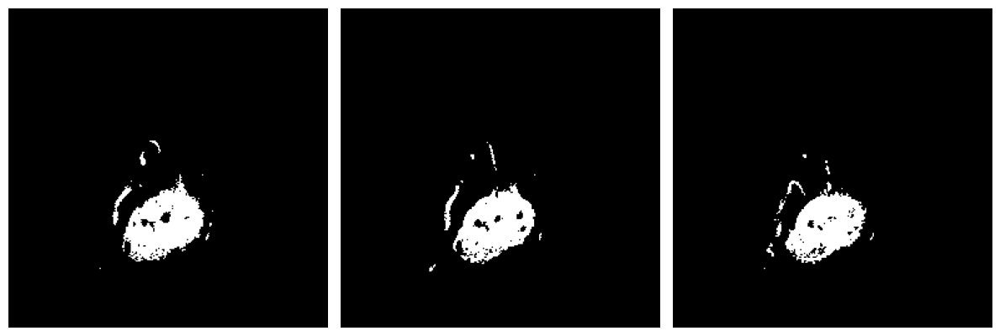

In [53]:
    pid='ACRIN-6698-511851'

    row = df[df.pid==pid].iloc[0]
    smask=int(row['mask_start'])
    emask = int(row['mask_end'])
    pmask = (smask+emask)//2
    nz=int(row['n_z'])
    nxy=int(row['n_xy'])
    print('mask: ', smask,emask)

    d=get_sorted_nifti_acquisitions(pid)
    m = get_nifti_mask(pid)

    im=to_rgb(d[0],d[1], d[2])
    show_n_images([to_rgb(d[0][k],d[1][k], d[2][k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([to_rgb(d[0][k],d[1][k], m[k]) for k in [pmask-1,pmask,pmask+1]])
    show_n_images([ m[k] for k in [pmask-1,pmask,pmask+1]])





In [54]:
len(d),d[0].shape,m.shape

(3, (28, 256, 256), (28, 256, 256))

## create sample jpg images for ISPY2

In [55]:
create_jpg_spy2_samples=False
deb=0

In [56]:
if create_jpg_spy2_samples:
    sample_dir = "BreastDCEDL_ISPY2_min_crop_jpg_samples"
    sample_dir = os.path.join(data_path, sample_dir)
    os.makedirs(sample_dir, exist_ok=True)

In [57]:
 if create_jpg_spy2_samples:
    for i,row in df[df.dataset=='spy2'].iterrows():

        pid = row['pid']
        print('===',i,pid)
        smask=int(row['mask_start'])
        emask = int(row['mask_end'])
        pmask = (smask+emask)//2
        nz=int(row['n_z'])
        nxy=int(row['n_xy'])
        nt = int(row['n_times'])


        b=get_sorted_nifti_acquisitions(pid)

        mb=get_nifti_mask(pid)

        df.at[i, 'n_z']=b[0].shape[0]
        nz = b[0].shape[0]

        assert(nxy==b[0].shape[1])

        assert(len(b)==3)
        for k in range(3):
            assert(b[k].shape==mb.shape)
            assert(nxy==b[k].shape[1])
            assert(nz==b[k].shape[0])


        p0 = int(row['pre'])
        p1 = int(row['post_early'])
        p2 = int(row['post_late'])

        imf = minmax(mb[pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_mask_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        imf = to_rgb(b[0][pmask],b[1][pmask],mb[pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_sample_wmask_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        imf = to_rgb(b[0][pmask],b[1][pmask],b[2][pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_sample_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        print('saved ',mfname)


# I-SPY1 example

In [58]:
pid='ISPY1_1072'
df[df.pid==pid]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
1960,ISPY1_1072,0.0,256.0,20.0,3.0,0.0,1.0,2.0,2.0625,0.78125,...,1.0,0.0,0.0,0.0,TripleNeg,1.0,0.0,0.0,spy1,0.0


spy1 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY1_min_crop/dce
['ISPY1_1219_spy1_vis1_dce_aqc_0.nii.gz', 'ISPY1_1219_spy1_vis1_dce_aqc_1.nii.gz', 'ISPY1_1219_spy1_vis1_dce_aqc_2.nii.gz', 'ISPY1_1177_spy1_vis1_dce_aqc_0.nii.gz', 'ISPY1_1177_spy1_vis1_dce_aqc_1.nii.gz', 'ISPY1_1177_spy1_vis1_dce_aqc_2.nii.gz', 'ISPY1_1196_spy1_vis1_dce_aqc_0.nii.gz'] ISPY1_1072
['ISPY1_1072_spy1_vis1_dce_aqc_0.nii.gz', 'ISPY1_1072_spy1_vis1_dce_aqc_1.nii.gz', 'ISPY1_1072_spy1_vis1_dce_aqc_2.nii.gz']
spy1 /content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_ISPY1_min_crop/mask
['ISPY1_1072_spy1_vis1_mask.nii.gz']
(20, 256, 256) 3


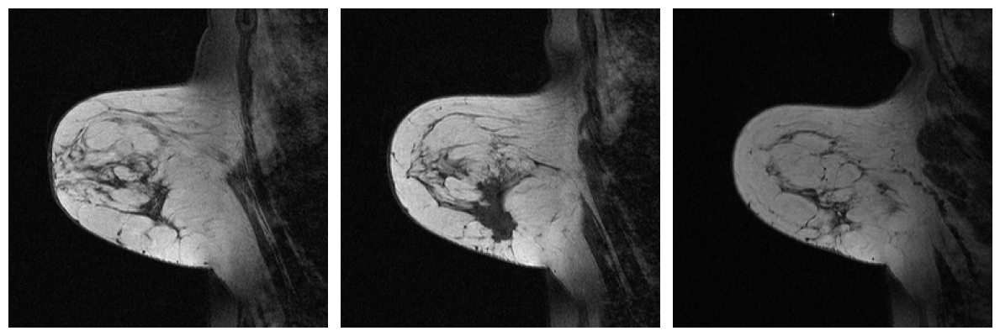

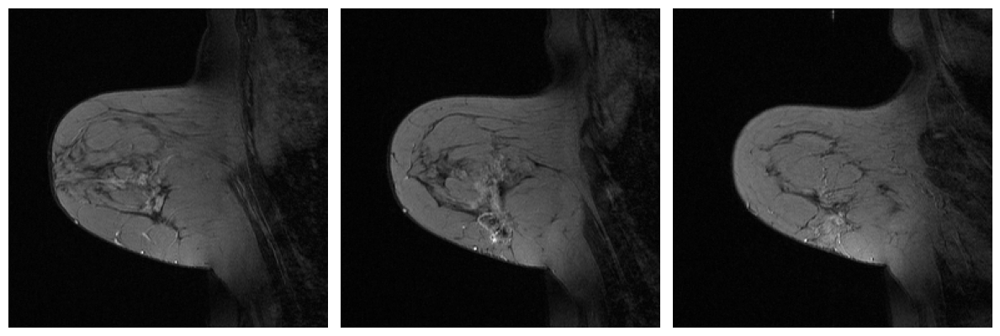

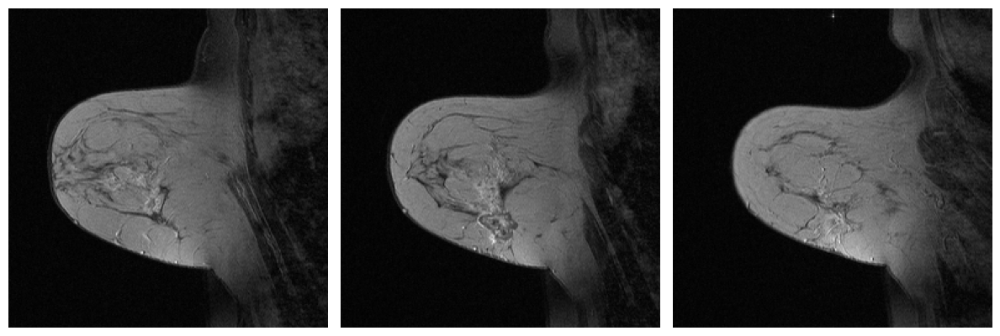

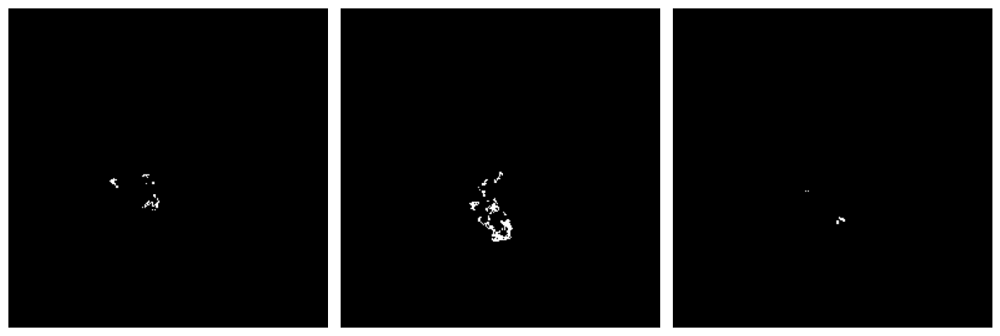

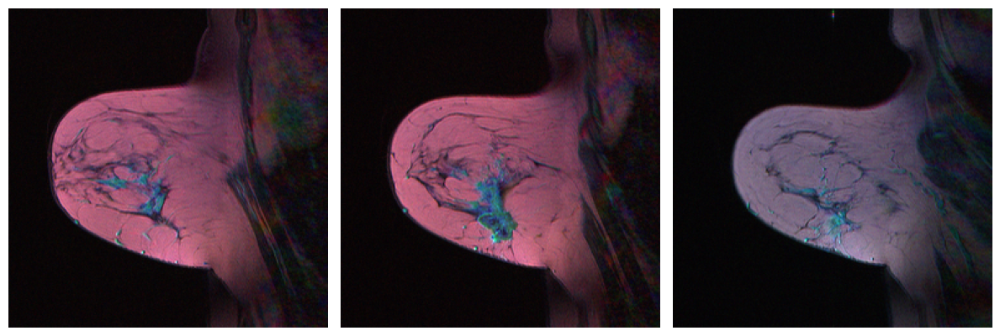

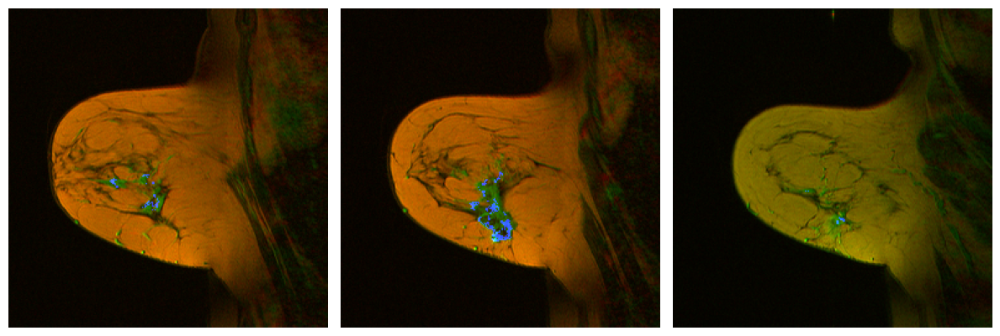

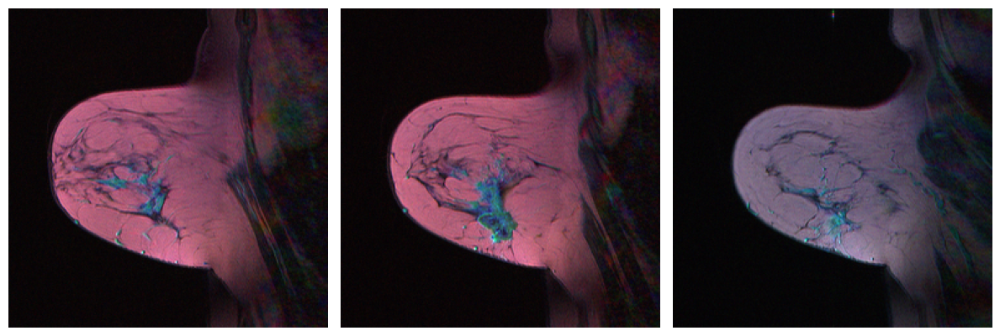

In [59]:
    deb=1
    d=get_sorted_nifti_acquisitions(pid)

    m=get_nifti_mask(pid)
    print(m.shape, len(d))
    idx=[5,10,15]
    show_n_images([d[0][k] for k in idx],axis_off=True)
    show_n_images([d[1][k] for k in idx],axis_off=True)
    show_n_images([d[2][k] for k in idx],axis_off=True)
    show_n_images([m[k] for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx],axis_off=True)
    show_n_images([to_rgb(d[0][k],
                                d[1][k],m[k]) for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx])


## create sample jpg images for ISPY1

In [61]:
deb=0
create_jpg_spy1_samples=False

In [62]:
if create_jpg_spy1_samples:
    sample_dir = "BreastDCEDL_ISPY1_min_crop_jpg_samples"
    sample_dir = os.path.join(data_path, sample_dir)
    os.makedirs(sample_dir, exist_ok=True)

In [63]:
if create_jpg_spy1_samples:

     for i,row in df[df.dataset=='spy1'].iterrows():


        pid = row['pid']
        print('===',pid)
        smask=int(row['mask_start'])
        emask = int(row['mask_end'])
        pmask = (smask+emask)//2
        nz=int(row['n_z'])
        nxy=int(row['n_xy'])
        nt = int(row['n_times'])


        b=get_sorted_nifti_acquisitions(pid)

        mb=get_nifti_mask(pid)


        nz = b[0].shape[0]

        assert(nxy==b[0].shape[1])

        assert(len(b)==3)
        for k in range(3):
            assert(b[k].shape==mb.shape)
            assert(nxy==b[k].shape[1])
            assert(nz==b[k].shape[0])

        df.at[i, 'n_z']=b[0].shape[0]

        imf = minmax(mb[pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_mask_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))


        imf = to_rgb(b[0][pmask],b[1][pmask],mb[pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_sample_wmask_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        imf = to_rgb(b[0][pmask],b[1][pmask],b[2][pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_sample_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        print('saved ',mfname)


### DUKE example

In [64]:
pid='Breast_MRI_001'
df[df.pid==pid]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
982,Breast_MRI_001,0.0,256.0,28.0,5.0,0.0,1.0,4.0,1.1,0.803571,...,0.0,1.0,0.0,1.0,HER2pos,0.0,1.0,0.0,duke,0.0


[  2  25 110 147 117 150]
3 (28, 256, 256)


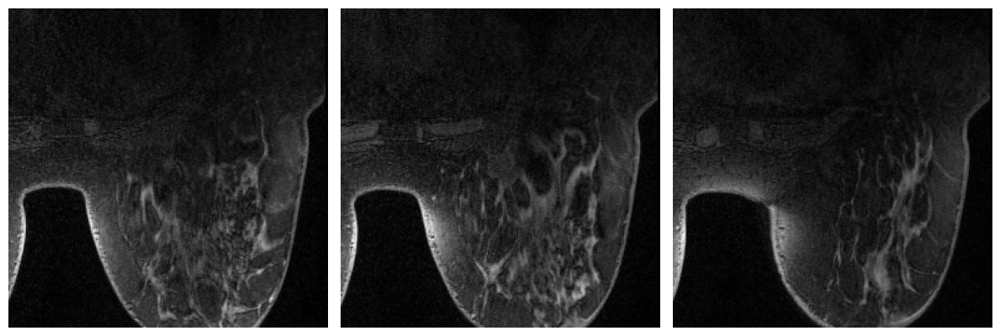

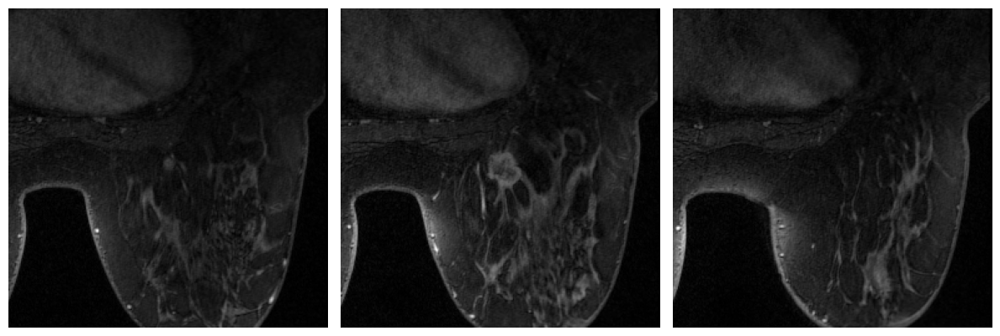

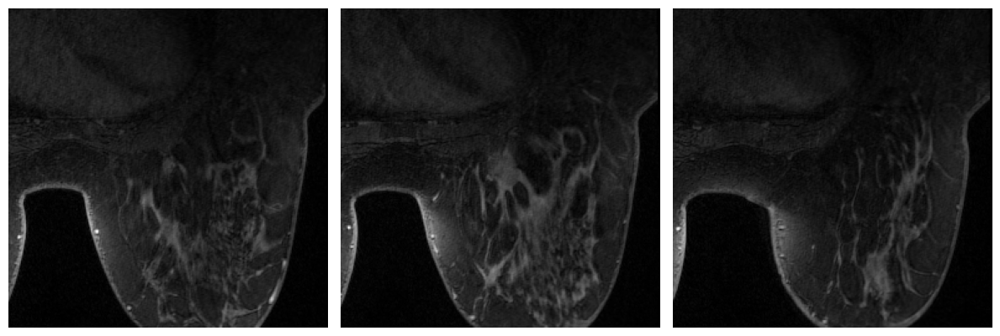

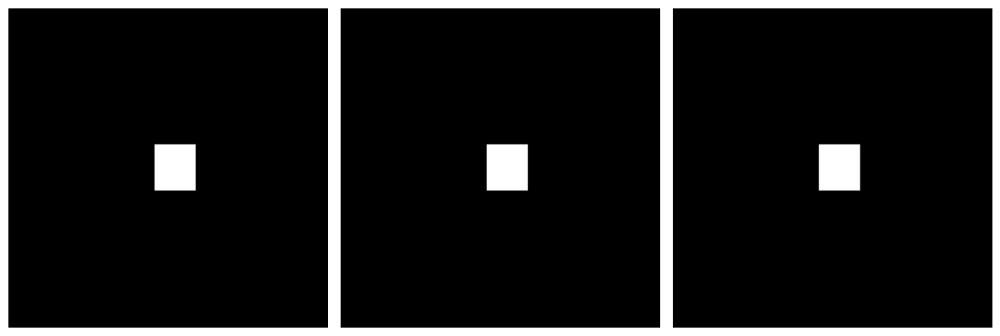

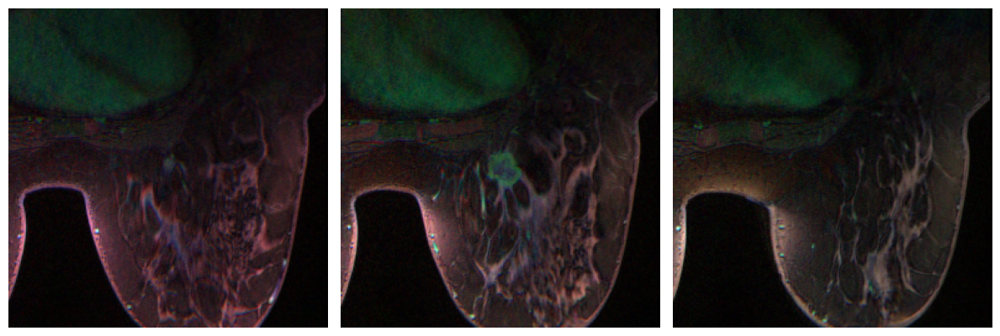

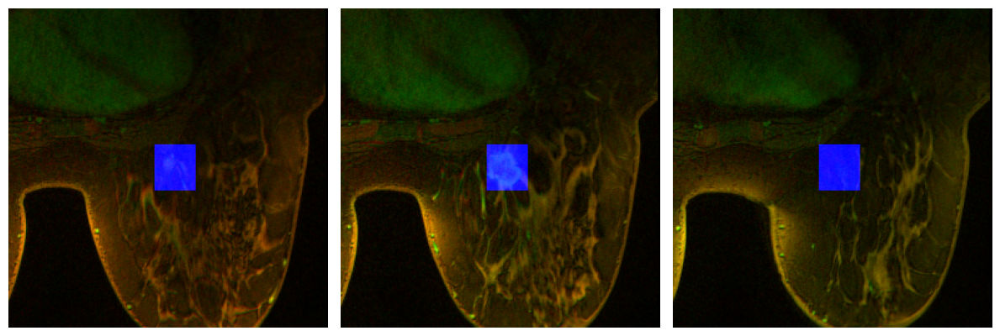

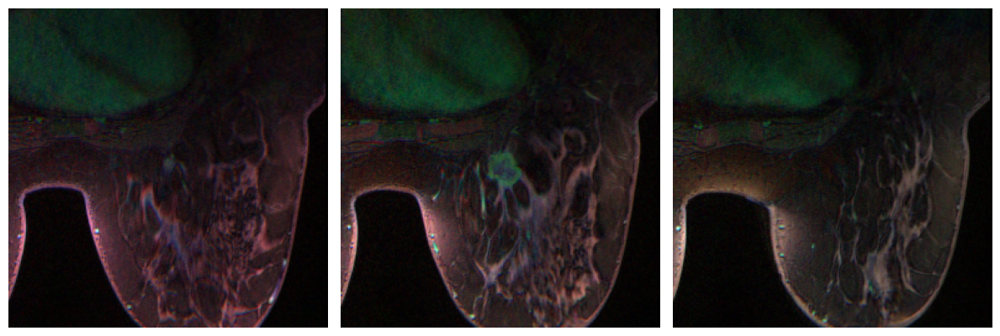

In [65]:

    bbox=df[df.pid==pid][['mask_start', 'mask_end',
           'sraw', 'eraw', 'scol', 'ecol']].values[0].astype(int)
    print(bbox)
    d=get_sorted_nifti_acquisitions(pid)
    print(len(d),d[0].shape)
    m=np.zeros(d[0].shape)
    m[bbox[0]:bbox[1], bbox[2]:bbox[3], bbox[4]:bbox[5]]=255
    idx=[bbox[0]+1,(bbox[0]+bbox[1])//2,bbox[1]-1]
    show_n_images([d[0][k] for k in idx],axis_off=True)
    show_n_images([d[1][k] for k in idx],axis_off=True)
    show_n_images([d[2][k] for k in idx],axis_off=True)
    show_n_images([m[k] for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx],axis_off=True)
    show_n_images([to_rgb(d[0][k],
                                d[1][k],m[k]) for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx])


In [66]:
pid='Breast_MRI_700'
df[df.pid==pid]

,pid,pCR,n_xy,n_z,n_times,pre,post_early,post_late,slice_thick,xy_spacing,...,race_white,race_black,HR,HER2,HR_HER2_STATUS,TripleNeg,HER2pos,HRposHER2neg,dataset,test
1677,Breast_MRI_700,NaN,256.0,32.0,3.0,0.0,1.0,2.0,2.0,0.758929,...,1.0,0.0,1.0,0.0,HRposHER2neg,0.0,0.0,1.0,duke,0.0


In [67]:
nifti_path['duke']

'/content/drive/MyDrive/breast_mri/BreastDCEDL_min_crop/BreastDCEDL_DUKE_min_crop/dce'

[  2  29 107 150 119 147]


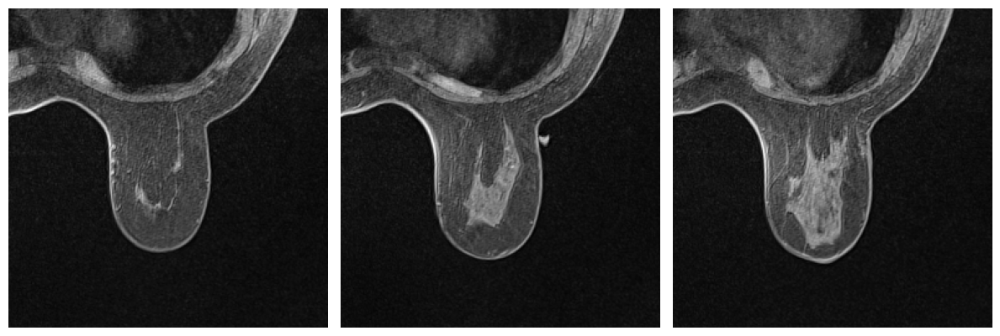

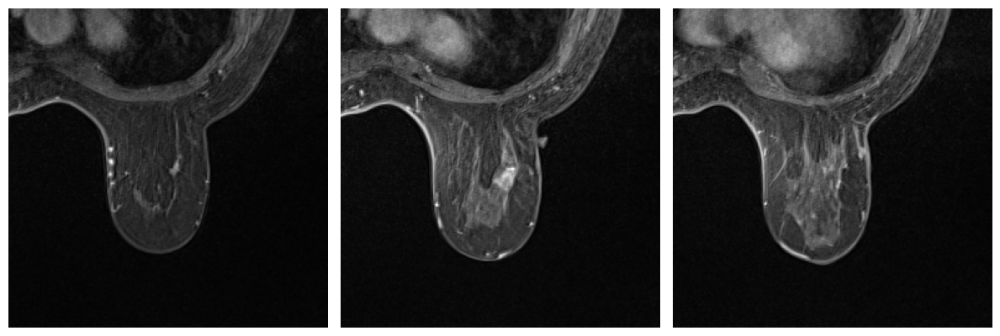

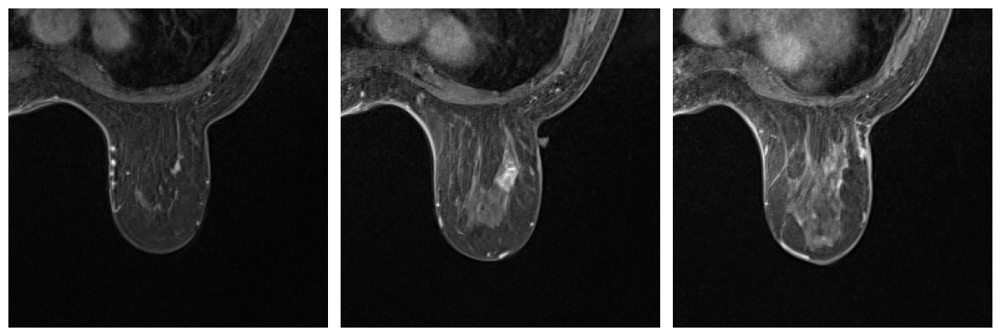

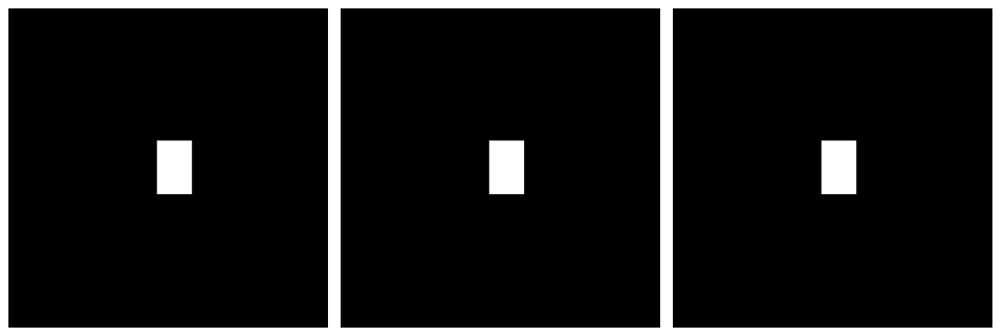

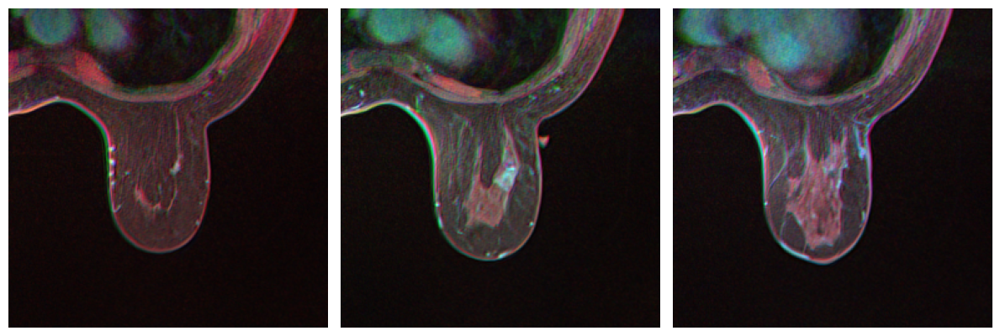

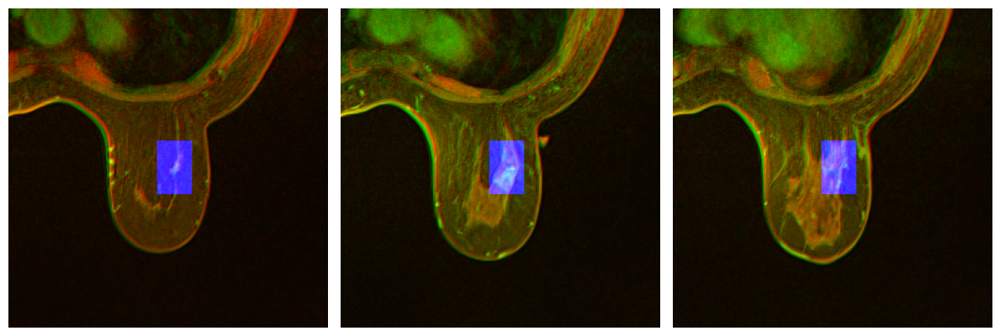

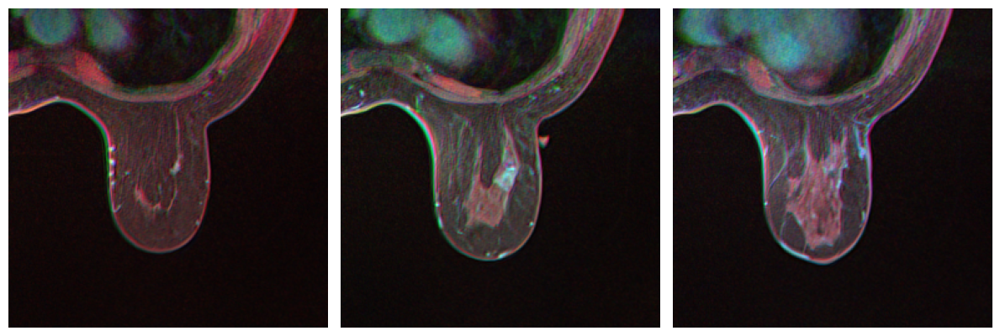

In [68]:

    bbox=df[df.pid==pid][['mask_start', 'mask_end',
           'sraw', 'eraw', 'scol', 'ecol']].values[0].astype(int)
    print(bbox)
    d=get_all_nifti_acquisitions(pid)
    m=np.zeros(d[0].shape)
    m[bbox[0]:bbox[1], bbox[2]:bbox[3], bbox[4]:bbox[5]]=255
    idx=[bbox[0]+1,(bbox[0]+bbox[1])//2,bbox[1]-1]
    show_n_images([d[0][k] for k in idx],axis_off=True)
    show_n_images([d[1][k] for k in idx],axis_off=True)
    show_n_images([d[2][k] for k in idx],axis_off=True)
    show_n_images([m[k] for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx],axis_off=True)
    show_n_images([to_rgb(d[0][k],
                                d[1][k],m[k]) for k in idx],axis_off=True)

    show_n_images([to_rgb(d[0][k],
                                d[1][k],d[2][k]) for k in idx])


## create sample jpg images for DUKE

In [69]:
deb=0
create_jpg_duke_samples=False

In [70]:
if create_jpg_duke_samples:
    sample_dir = "BreastDCEDL_DUKE_min_crop_jpg_samples"
    sample_dir = os.path.join(data_path, sample_dir)
    os.makedirs(sample_dir, exist_ok=True)

In [71]:
 if create_jpg_duke_samples:

    for i,row in df[df.dataset=='duke'].iterrows():


        pid = row['pid']
        print('===',pid)
        smask=int(row['mask_start'])
        emask = int(row['mask_end'])
        pmask = (smask+emask)//2
        nz=int(row['n_z'])
        nxy=int(row['n_xy'])
        nt = int(row['n_times'])


        b=get_sorted_nifti_acquisitions(pid)

        bbox=row[['mask_start', 'mask_end',
           'sraw', 'eraw', 'scol', 'ecol']].astype(int)
        if deb: print(bbox)

        mb=np.zeros(b[0].shape)
        mb[bbox[0]:bbox[1], bbox[2]:bbox[3], bbox[4]:bbox[5]]=255


        nz = b[0].shape[0]

        assert(nxy==b[0].shape[1])

        assert(len(b)==3)
        for k in range(3):
            assert(b[k].shape==mb.shape)
            assert(nxy==b[k].shape[1])
            assert(nz==b[k].shape[0])

        df.at[i, 'n_z']=b[0].shape[0]

        imf = minmax(mb[pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_mask_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))


        imf = to_rgb(b[0][pmask],b[1][pmask],mb[pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_sample_wmask_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        imf = to_rgb(b[0][pmask],b[1][pmask],b[2][pmask])
        imf = (imf*255).astype(np.uint8)
        mfname  = pid+'_min_crop_sample_'+str(pmask)+'.png'
        Image.fromarray(imf).save(os.path.join(sample_dir,  mfname))

        print('saved ',mfname)
